In [1]:
import seaborn as sns
from collections import defaultdict
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from os import path
from scipy.stats import wilcoxon

In [2]:
dimensions = [30]
ROOTPATH = f'/home/rcls/codigos/git-projects/analysis-volitive-gwo/results/'
algorithms = ['VGWO', "GWO"]
max_iter = 1000
num_agents = 30
max_eval = num_agents * max_iter + num_agents
multimodal_functions = ['Rastrigin','Generalized-Shwefel', "Ackley", "Levi", "Griewank"]
unimodal_functions = ['Sphere','RotatedHyperEllipsoid', "Rosenbrock", "Dixon-Price", "Quartic-Noise"]
functions = multimodal_functions + unimodal_functions
simulations = 20
name=f"%s_dim_%d_agents_%d_iter_%d_eval_%d.csv_%s_convergence.csv"

In [3]:
results = defaultdict(dict)

for dimension in dimensions:
    results[dimension] = defaultdict(dict)
    
    for func in functions:
        results[dimension][func] = defaultdict(dict)
        for algo in algorithms:    
            filename = name % (algo, dimension, num_agents, max_iter, max_eval, func)
            df = pd.read_csv(ROOTPATH+filename)
            #results[dimension][func][algo] = df
            df.drop(columns=['Unnamed: 0'], axis=1, inplace=True)
            for simulation in range(simulations):
                results[dimension][func][algo][simulation] = df[f'convergence_simulation_{simulation}'].tolist()[0:max_iter]        


In [56]:
results

defaultdict(dict,
            {30: defaultdict(dict,
                         {'Rastrigin': defaultdict(dict,
                                      {'VGWO': {0: [272.0013668917043,
                                         272.0013668917043,
                                         232.34473301439627,
                                         232.34473301439627,
                                         178.32993062485622,
                                         166.16088558914387,
                                         163.23315646100886,
                                         101.57857189195768,
                                         38.84067752295476,
                                         23.36480957443507,
                                         10.974726759242005,
                                         6.034076003889481,
                                         4.592421485748673,
                                         2.8413706494653184,
                               

# Data Transform

In [5]:
database_convergence = pd.DataFrame({'Fitness': [], 'Dimension': [], 'Iteration': []})
for dimension in dimensions:
    for func in results[dimension]:
        for algo in results[dimension][func]:
            for simulation in results[dimension][func][algo]:
                rows_len = len(results[dimension][func][algo][simulation]) 
                temp_database = pd.DataFrame({'Iteration': list(range(0, rows_len)), 'Algorithm': [algo]*rows_len, 'Function': [func]*rows_len, 'Dimension': [dimension]*rows_len, 'Simulation': [simulation]*rows_len, 'Fitness': results[dimension][func][algo][simulation]})
                #database = database.append(new_row, ignore_index=True)
                database_convergence = pd.concat((database_convergence, temp_database))

database_convergence.reset_index(drop=True, inplace=True)

database_convergence['Dimension'] = database_convergence['Dimension'].astype(int)
database_convergence['Iteration'] = database_convergence['Iteration'].astype(int)
database_convergence['Simulation'] = database_convergence['Simulation'].astype(int)                    

In [6]:
database = pd.DataFrame({'Fitness': [], 'Dimension': [], 'Iteration': []})
for dimension in dimensions:
    for func in results[dimension]:
        for algo in results[dimension][func]:
            for simulation in results[dimension][func][algo]:
                rows_len = len(results[dimension][func][algo][simulation]) 
                #temp_database = pd.DataFrame({'Iteration': rows_len, 'Algorithm': algo, 'Function': func, 'Dimension': dimension, 'Simulation': simulation, 'Fitness': results[dimension][func][algo][simulation][-1]})
                new_row = {'Iteration': rows_len, 'Algorithm': algo, 'Function': func, 'Dimension': dimension, 'Simulation': simulation, 'Fitness': results[dimension][func][algo][simulation][-1]}
                database = database.append(new_row, ignore_index=True)
                #database = pd.concat((database, temp_database))

database.reset_index(drop=True, inplace=True)

database['Dimension'] = database['Dimension'].astype(int)
database['Iteration'] = database['Iteration'].astype(int)
database['Simulation'] = database['Simulation'].astype(int)                    

/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecat

/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecat

/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecat

/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  database = database.append(new_row, ignore_index=True)
/tmp/ipykernel_151647/513500831.py:9: FutureWarning: The frame.append method is deprecat

      Fitness  Dimension  Iteration Algorithm   Function  Simulation
0    0.000000         30        500      VGWO  Rastrigin           0
1    0.000000         30        500      VGWO  Rastrigin           1
2    0.000000         30        500      VGWO  Rastrigin           2
3    0.000000         30        500      VGWO  Rastrigin           3
4    0.000000         30        500      VGWO  Rastrigin           4
5    0.000000         30        500      VGWO  Rastrigin           5
6    0.000000         30        500      VGWO  Rastrigin           6
7    0.000000         30        500      VGWO  Rastrigin           7
8    0.000000         30        500      VGWO  Rastrigin           8
9    0.000000         30        500      VGWO  Rastrigin           9
10   0.000000         30        500      VGWO  Rastrigin          10
11   0.000000         30        500      VGWO  Rastrigin          11
12   0.000000         30        500      VGWO  Rastrigin          12
13   0.000000         30        50

      Fitness  Dimension  Iteration Algorithm Function  Simulation
120  0.039292         30        500      VGWO     Levi           0
121  0.004000         30        500      VGWO     Levi           1
122  0.042373         30        500      VGWO     Levi           2
123  0.022414         30        500      VGWO     Levi           3
124  0.070291         30        500      VGWO     Levi           4
125  0.020473         30        500      VGWO     Levi           5
126  0.052214         30        500      VGWO     Levi           6
127  0.067118         30        500      VGWO     Levi           7
128  0.072148         30        500      VGWO     Levi           8
129  0.044550         30        500      VGWO     Levi           9
130  0.082079         30        500      VGWO     Levi          10
131  0.035908         30        500      VGWO     Levi          11
132  0.037775         30        500      VGWO     Levi          12
133  0.074100         30        500      VGWO     Levi        

       Fitness  Dimension  Iteration Algorithm    Function  Simulation
280  28.738533         30        500      VGWO  Rosenbrock           0
281  28.091174         30        500      VGWO  Rosenbrock           1
282  28.777293         30        500      VGWO  Rosenbrock           2
283  28.531684         30        500      VGWO  Rosenbrock           3
284  28.598055         30        500      VGWO  Rosenbrock           4
285  28.375420         30        500      VGWO  Rosenbrock           5
286  28.741048         30        500      VGWO  Rosenbrock           6
287  28.486046         30        500      VGWO  Rosenbrock           7
288  28.661352         30        500      VGWO  Rosenbrock           8
289  28.697384         30        500      VGWO  Rosenbrock           9
290  28.370162         30        500      VGWO  Rosenbrock          10
291  28.517682         30        500      VGWO  Rosenbrock          11
292  28.763618         30        500      VGWO  Rosenbrock          12
293  2

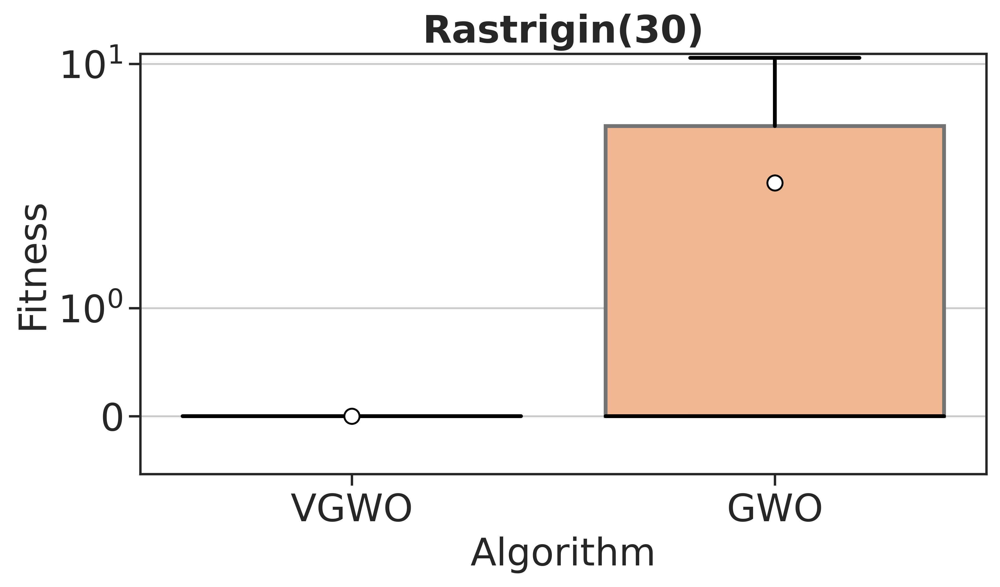

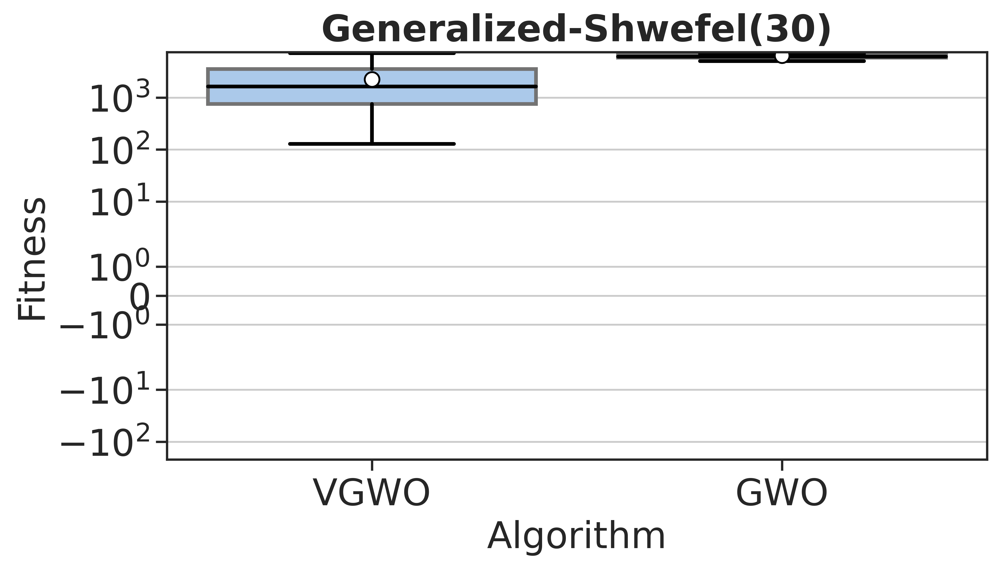

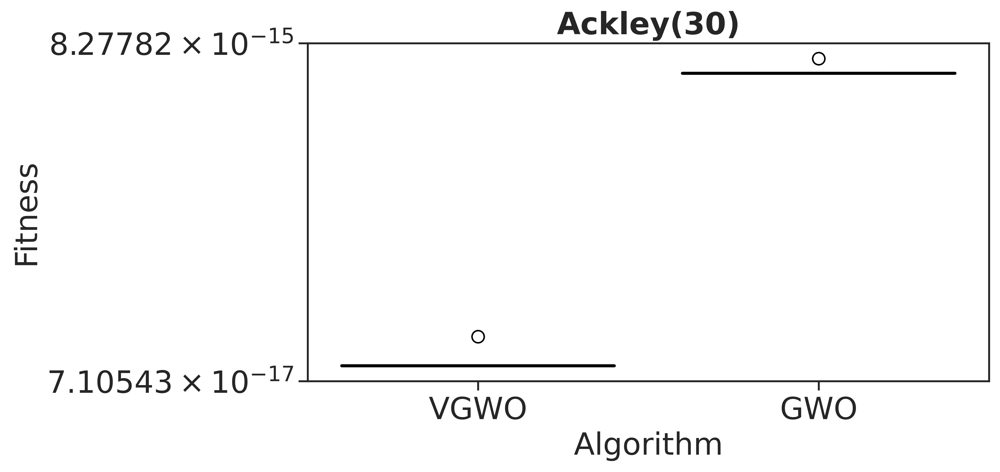

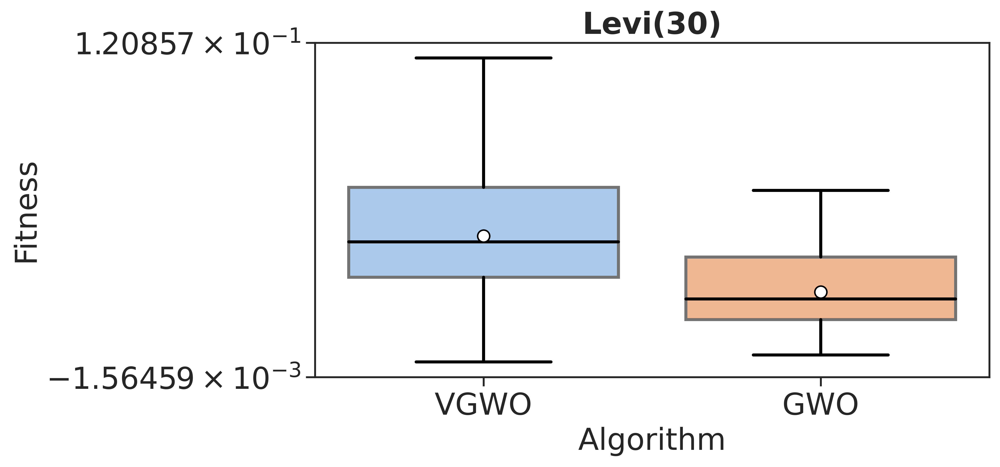

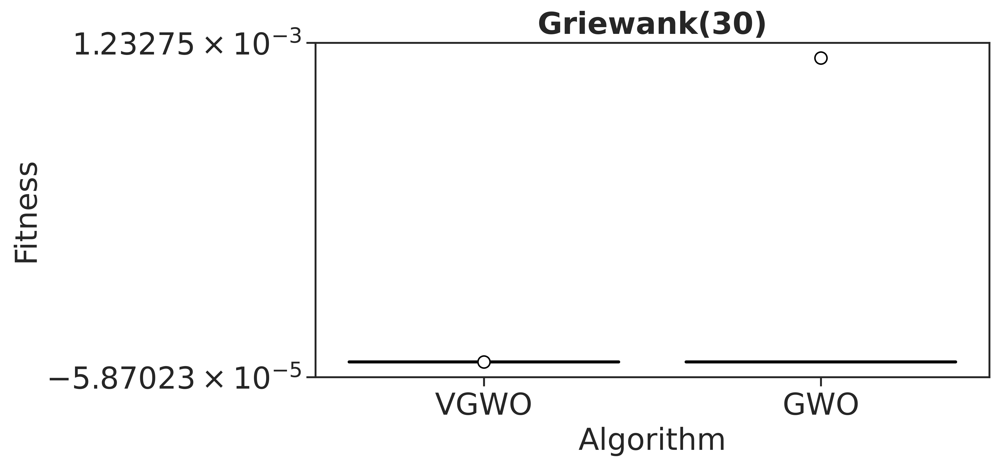

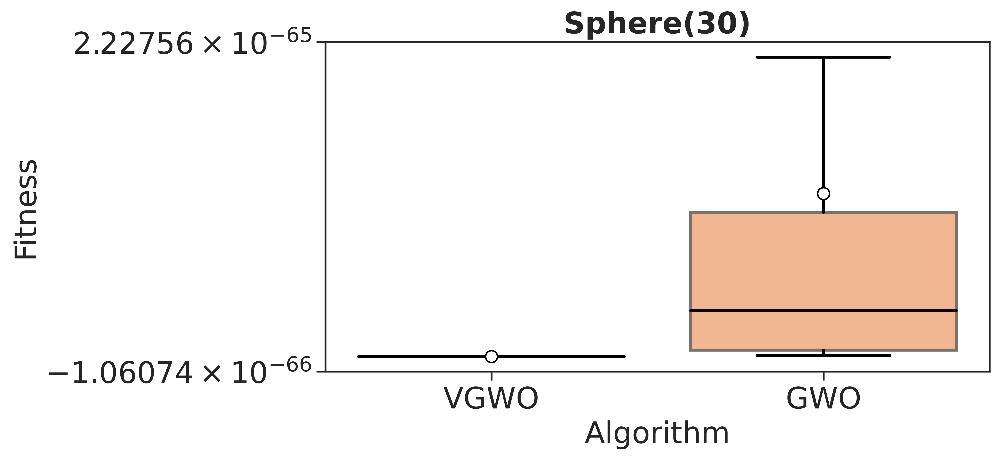

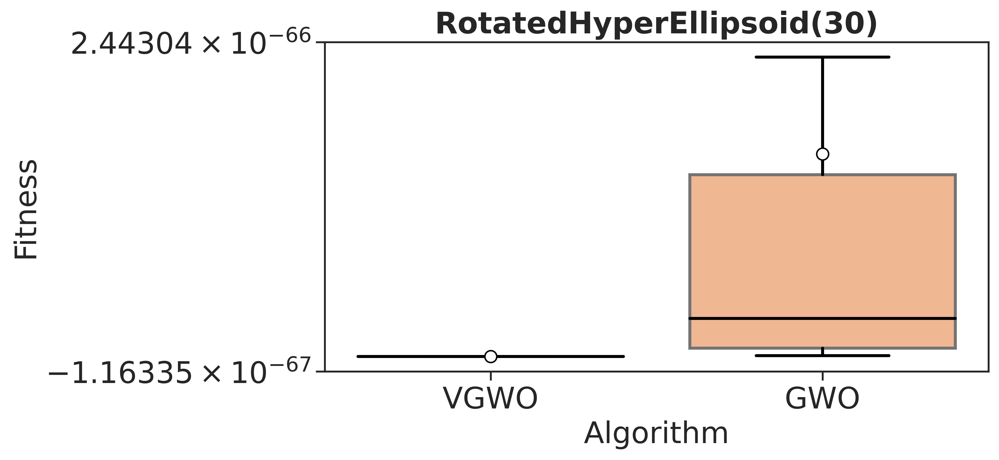

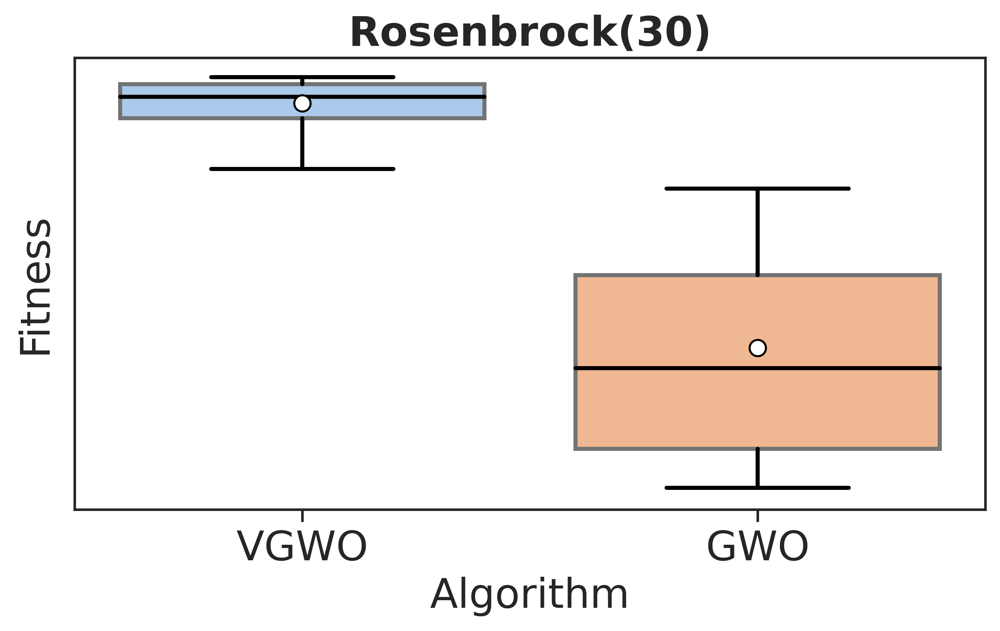

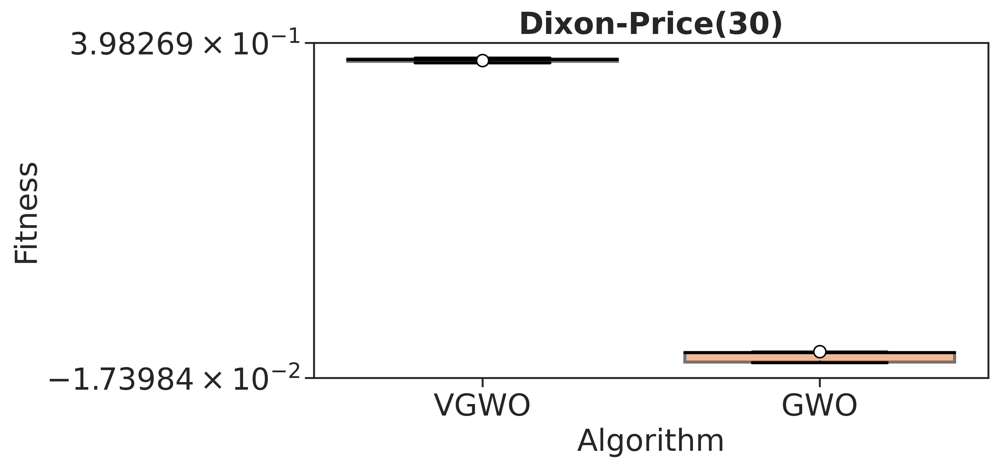

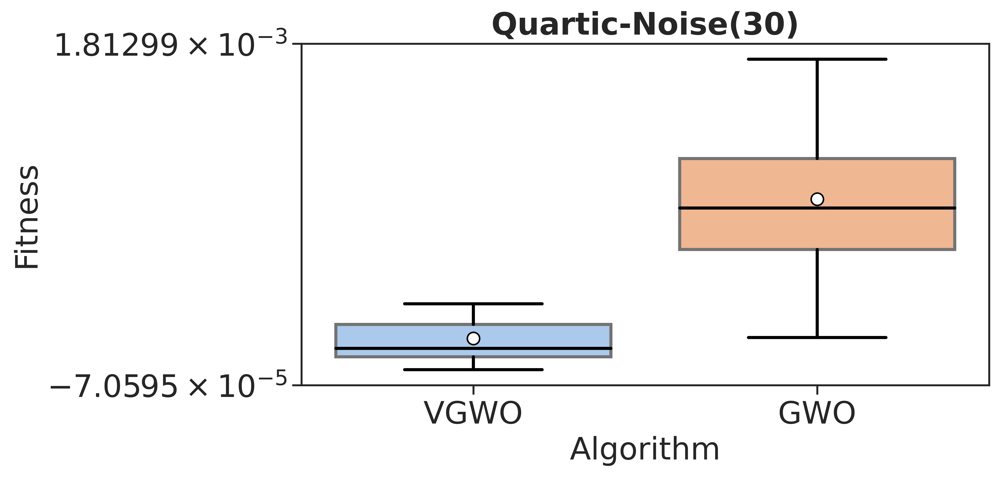

In [8]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})

PROPS = {  
    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
}

MEANPROPS={"marker":"o",
                       "markerfacecolor":"white", 
                       "markeredgecolor":"black",
                      "markersize":"8"}

sns.set_style("ticks")
sns.set_theme(style="ticks", palette="pastel")
label_size = 20
#plt.rc('legend', fontsize = label_size)

for function in functions:
    fig, ax = plt.subplots(figsize=(8,4)) #13,8
    df_filtered_func = database[database['Function'] == function]
    for pos, dimension in enumerate(dimensions):
        
        #ax.ticklabel_format(axis="x", style="sci", scilimits=(0,0))
        
        df_filteres = df_filtered_func[df_filtered_func['Dimension'] == dimension]
        #print(df_filteres)
        #input()
        b = sns.boxplot(x='Algorithm',  data=df_filteres, y='Fitness', hue=f'Algorithm', showfliers=False, 
                    orient = 'v', ax = ax, width=0.8, linewidth = 2, **PROPS, showmeans=True, meanprops=MEANPROPS
                       ,dodge = False)
        
        #if function == "Rastrigin":
        #    function_name = function
        #elif function == "F3_MODIFIED":
        #    function_name = "F3"
            
        ax.set_title(f"{function}({dimension})", fontsize=label_size, fontweight="bold")
        ax.legend_.remove()

        #if pos == 1:
        #    ax.set(ylabel=None)
        
        #if function not in ["ShiftedRastrigin", "ShiftedRotatedRastrigin"]:
        ax.set_yscale("symlog")
            
        ax.yaxis.grid(True) # Hide the horizontal gridlines
        ax.xaxis.grid(False)
        #ax[pos].xaxis.grid(True) # Show the vertical gridlines
        #ax.ticklabel_format(axis="x", style="sci", scilimits=(0,0))
        #plt.legend(loc='upper right')

        #sns.despine(offset=5, trim=True)        
        ax.xaxis.set_tick_params(labelsize = label_size)
        ax.yaxis.set_tick_params(labelsize = label_size)
        ax.set_xlabel(ax.get_xlabel(), fontsize=label_size)
        ax.set_ylabel(ax.get_ylabel(), fontsize=label_size)



# Convergence

/tmp/ipykernel_125700/3096964301.py:29: UserWarning: The markers list has more values (4) than needed (2), which may not be intended.
  sns.lineplot(x='Iteration', data=df_filtered, y="Fitness", hue='Algorithm', ax = ax,
/tmp/ipykernel_125700/3096964301.py:29: UserWarning: The markers list has more values (4) than needed (2), which may not be intended.
  sns.lineplot(x='Iteration', data=df_filtered, y="Fitness", hue='Algorithm', ax = ax,
/tmp/ipykernel_125700/3096964301.py:29: UserWarning: The markers list has more values (4) than needed (2), which may not be intended.
  sns.lineplot(x='Iteration', data=df_filtered, y="Fitness", hue='Algorithm', ax = ax,
/tmp/ipykernel_125700/3096964301.py:29: UserWarning: The markers list has more values (4) than needed (2), which may not be intended.
  sns.lineplot(x='Iteration', data=df_filtered, y="Fitness", hue='Algorithm', ax = ax,
/tmp/ipykernel_125700/3096964301.py:29: UserWarning: The markers list has more values (4) than needed (2), which may

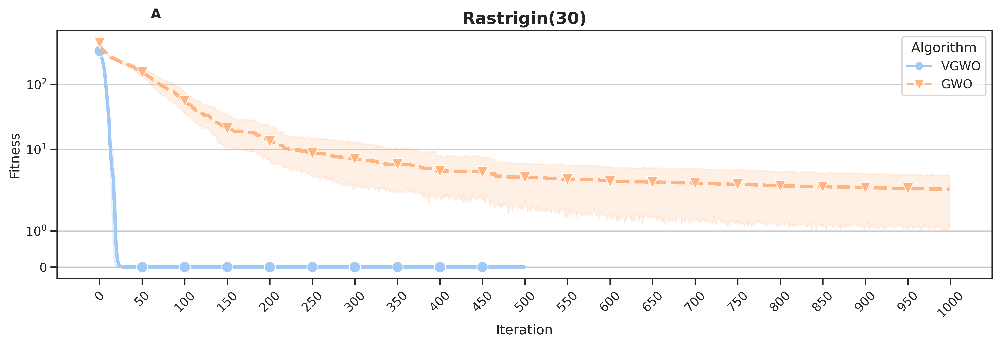

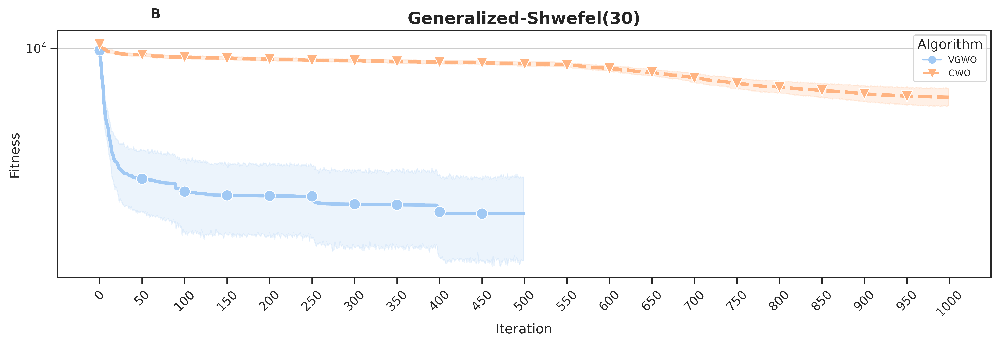

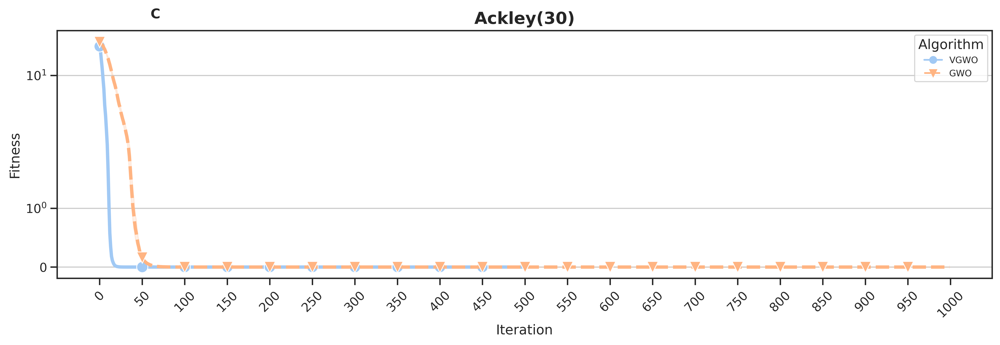

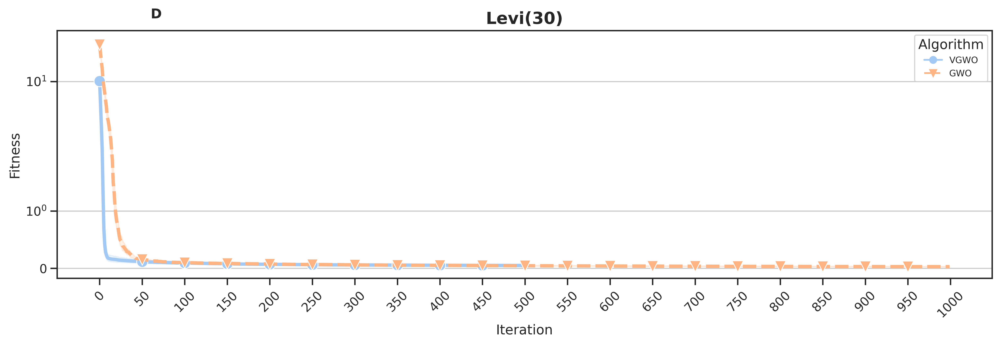

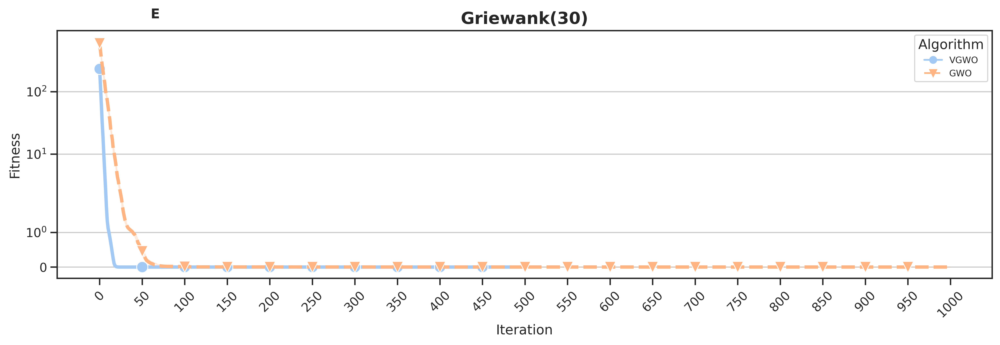

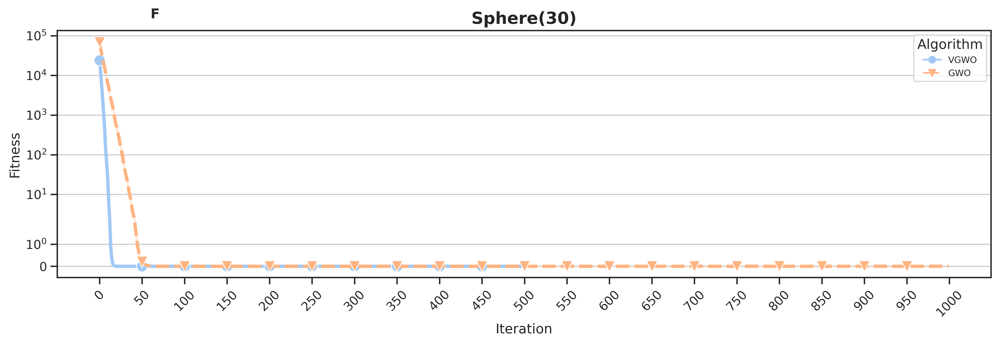

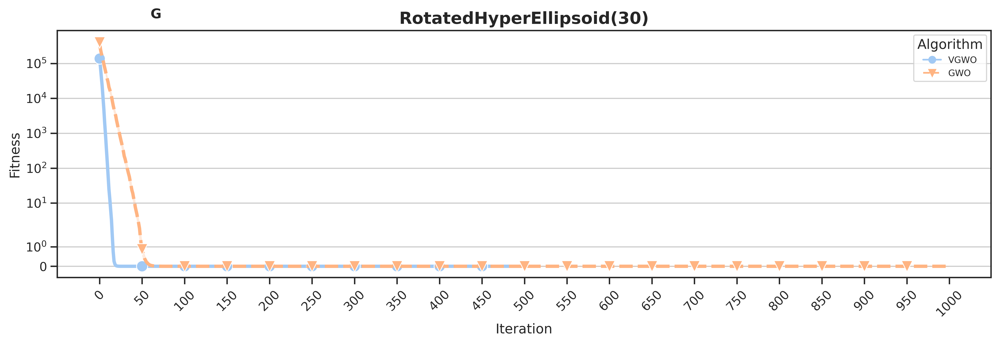

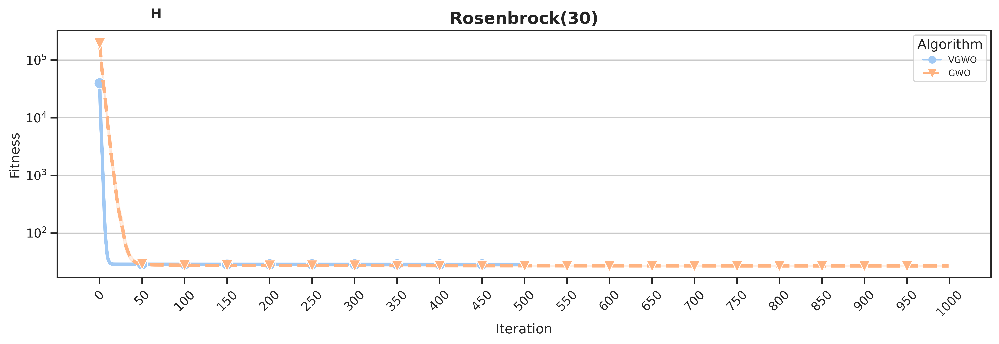

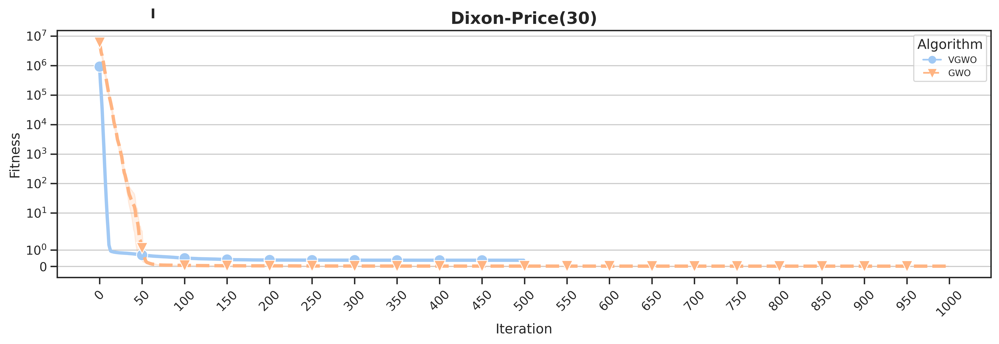

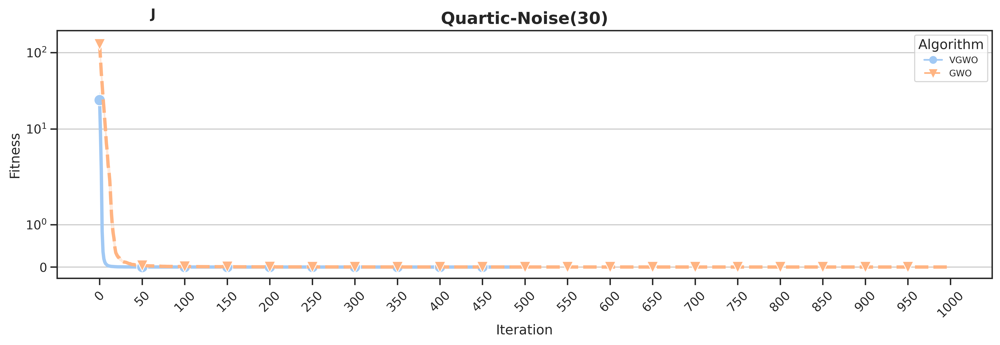

In [64]:
sns.set(rc={"figure.dpi":500, 'savefig.dpi':500})

PROPS = {

    'medianprops':{'color':'black'},
    'whiskerprops':{'color':'black'},
    'capprops':{'color':'black'}
}

label = ord('A')
font_size_out = 10
sns.set_theme(style="ticks", palette="pastel")

for lin, dim in enumerate(dimensions):
    df_dim = database_convergence[database_convergence['Dimension'] == dim]
    for col, function in enumerate(functions):
        fig, ax = plt.subplots(figsize = (15, 4))
        fig.subplots_adjust(wspace=0.1, hspace=0.2)
        ax.get_xaxis().get_offset_text().set_position((0.5,0))
        
            
        ax.set_title(f"{function}({dim})", fontsize=15, fontweight="bold")
        my_y = 1.05
        my_x = 0.1

        ax.text(my_x, my_y,f"{chr(label)}",fontsize=font_size_out*1.2,transform=ax.transAxes, weight="bold")
        
        df_filtered = df_dim[df_dim['Function'] == function]        
        sns.lineplot(x='Iteration', data=df_filtered, y="Fitness", hue='Algorithm', ax = ax, 
                    markers = ['o', 'v', '^', '<'], markersize = 10, linewidth = 3, style = 'Algorithm',
                    markevery=50)
        
        
        ax.yaxis.grid(True) # Hide the horizontal gridlines
        ax.xaxis.grid(False)
        #ax[col].set_ylabel(ylabeltext, fontsize=15)
        ax.set_yscale("symlog")

#        if (col == 1):
#            ax.set_ylabel("", fontsize=15)  

        #ax[col].set_xlabel(xlabeltext, fontsize=15)
        #ax[col].ticklabel_format(axis="y", style="sci", scilimits=(0,0))
        ax.set_xticks(range(0, max_iter+50, 50)) # <--- set the ticks first
        ax.set_xticklabels(ax.get_xticks(), rotation = 45)

        plt.rc('legend', fontsize = 8)
        label+=1         

# Wilcoxon

In [12]:
proposal = "VGWO"

In [13]:
alpha = 0.05

dicionario_wilcoxon = defaultdict(dict)

for dimension in dimensions:
    print(f'\n{dimension} dimensions')
    for func in functions:
        print(f'\n\t{func}({dimension})')
        proposal_results = [results[dimension][func][proposal][simulation_id][-1]
         for simulation_id in results[dimension][func][proposal]]
        mean_proposal = np.mean(proposal_results)
        print(f'\t{mean_proposal} ({np.std(proposal_results)})')
        dicionario_wilcoxon[dimension][func] = defaultdict(dict)
        dicionario_wilcoxon[dimension][func][proposal] = {'mean': mean_proposal, 'std':  np.std(proposal_results), 'wilcoxon': '-'}
        
        for algo in results[dimension][func]:
            if algo == proposal:
                continue
                
            other_algo_results = [ results[dimension][func][algo][simulation_id][-1] for simulation_id in results[dimension][func][algo]]
            mean_other = np.mean(other_algo_results)
            try:
                stat, p = wilcoxon(np.absolute(proposal_results), np.absolute(other_algo_results))                
                print(f'{stat}, {p} ')
                print(f'\t\t{mean_other} ({np.std(other_algo_results)})' , end= '')
                print (f' | {proposal} x {algo}', end= '')
                
                if p > alpha:
                    dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '--'}
                    print(' -> Same distribution (fail to reject H0) - ')
                else:                    
                    print(' -> Different distribution (reject H0) ', end='')
                    if mean_proposal < mean_other: # menor é melhor
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '$\\blacktriangle$'}
                        print(' proposal melhor')
                    elif mean_proposal > mean_other:
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': '$\\blacktriangledown$'}
                        print(' proposal pior')
                    else:
                        dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': 'x'}
                        print(' proposal igual') # acho que isso não pode
                        
            except ValueError as err:
                    dicionario_wilcoxon[dimension][func][algo] = {'mean': mean_other, 'std':  np.std(other_algo_results), 'wilcoxon': 'error'}
                    print(err)                
        
        print("-".center(100,"-"))



30 dimensions

	Rastrigin(30)
	0.0 (0.0)
0.0, 0.007685794055213263 
		2.4471118061978814 (3.334624963709534) | VGWO x GWO -> Different distribution (reject H0)  proposal melhor
----------------------------------------------------------------------------------------------------

	Generalized-Shwefel(30)
	2225.4056444174194 (1900.0855564204585)
1.0, 3.814697265625e-06 
		6417.803755852337 (1200.6327818678353) | VGWO x GWO -> Different distribution (reject H0)  proposal melhor
----------------------------------------------------------------------------------------------------

	Ackley(30)
	1.1546319456101628e-15 (1.4210854715202008e-15)
0.0, 1.9073486328125e-06 
		7.904787935331115e-15 (1.5485919901226006e-15) | VGWO x GWO -> Different distribution (reject H0)  proposal melhor
----------------------------------------------------------------------------------------------------

	Levi(30)
	0.05015101603015233 (0.025346998452074086)
33.0, 0.005580902099609375 
		0.029615191914067373 (0.0148